In [1]:
import datetime
import sys, os
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

In [2]:
import scanpy as sc
sc.logging.print_memory_usage()
sc.settings.verbosity = 2
sc.settings.set_figure_params(dpi = 300, dpi_save = 300)
sc.logging.print_header()

from matplotlib.pyplot import rc_context

Memory usage: current 0.20 GB, difference +0.20 GB
scanpy==1.10.1 anndata==0.10.7 umap==0.5.5 numpy==1.26.4 scipy==1.13.0 pandas==2.2.2 scikit-learn==1.4.2 statsmodels==0.14.1 igraph==0.11.4 pynndescent==0.5.12


In [3]:
# add the utility functions folder to PATH
sys.path.append(os.path.abspath("../packages"))
from db_dev.helper import *

In [4]:
home_dir = os.path.expanduser("~")
current_directory = os.getcwd()

adata = sc.read_h5ad(current_directory+"/backups/bb2_bb3_norm_filtered_log_hvg_z_pca_harmony_after_filtering_and_doublet_95563x2500_240710_14h11.h5ad")

# Initial clustering

running Leiden clustering
    finished (0:00:04)


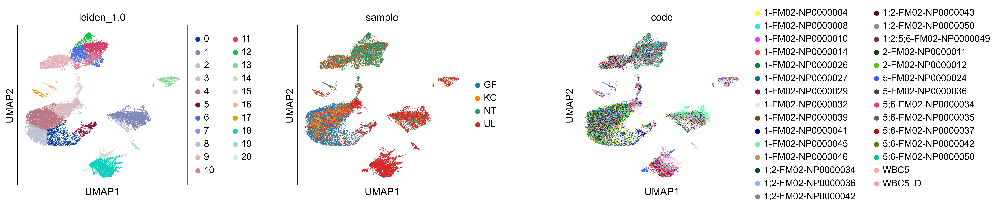

In [5]:
sc.tl.leiden(adata, flavor = "igraph", resolution = 1, key_added = "leiden_1.0")
sc.pl.umap(adata, color = ["leiden_1.0", "sample", "code"], 
           alpha = 1, 
           wspace = 0.5,
           ncols = 3,
           s = 1,
           save = "_leiden_1.0_v1.png")
#  n_iterations = 2

running Leiden clustering
    finished (0:00:05)


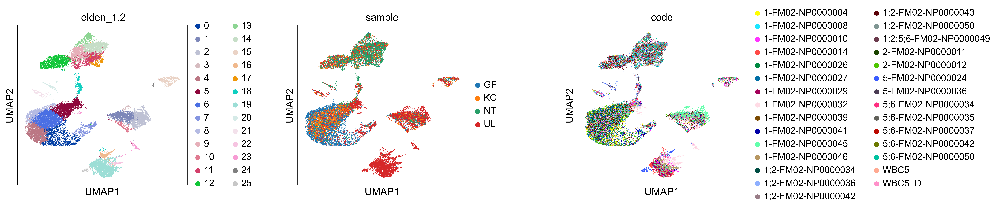

In [6]:
sc.tl.leiden(adata, flavor = "igraph", resolution = 1.2, key_added = "leiden_1.2")
sc.pl.umap(adata, color = ["leiden_1.2", "sample", "code"], 
           alpha = 1, 
           wspace = 0.5,
           ncols = 3,
           s = 1,
           save = "_leiden_1.2_v1.png")

#n_iterations = 2

running Leiden clustering
    finished (0:00:04)


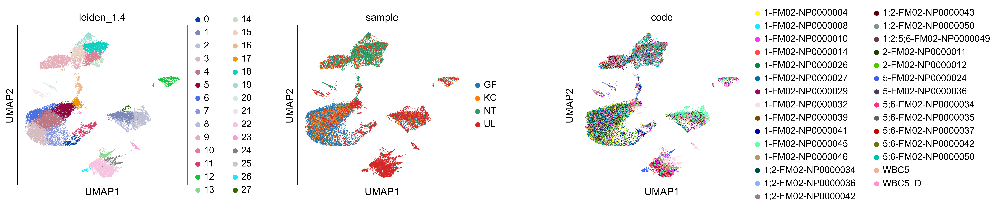

In [9]:
sc.tl.leiden(adata, flavor = "igraph", resolution = 1.4, key_added = "leiden_1.4")
sc.pl.umap(adata, color = ["leiden_1.4", "sample", "code"], 
           alpha = 1, 
           wspace = 0.5,
           ncols = 3,
           s = 1,
           save = "_leiden_1.4_v1.png")

#n_iterations = 2

# Subclustering

In [29]:

sc.tl.leiden(adata, 
             flavor = "igraph", 
             restrict_to=("leiden_1.4", ["11"]), 
             resolution = 0.2,
             key_added = "leiden_1.4_sub")

sc.tl.leiden(adata, 
             flavor = "igraph", 
             restrict_to=("leiden_1.4_sub", ["16"]), 
             resolution = 0.1,
             key_added = "leiden_1.4_sub")


sc.tl.leiden(adata, 
             flavor = "igraph", 
             restrict_to=("leiden_1.4_sub", ["2"]), 
             resolution = 0.2,
             key_added = "leiden_1.4_sub")


sc.tl.leiden(adata, 
             flavor = "igraph", 
             restrict_to=("leiden_1.4_sub", ["12"]), 
             resolution = 0.15,
             key_added = "leiden_1.4_sub")


sc.tl.leiden(adata, 
             flavor = "igraph", 
             restrict_to=("leiden_1.4_sub", ["24"]), 
             resolution = 0.1,
             key_added = "leiden_1.4_sub")



sc.tl.leiden(adata, 
             flavor = "igraph", 
             restrict_to=("leiden_1.4_sub", ["13"]), 
             resolution = 0.1,
             key_added = "leiden_1.4_sub")


sc.tl.leiden(adata, 
             flavor = "igraph", 
             restrict_to=("leiden_1.4_sub", ["22"]), 
             resolution = 0.4,
             key_added = "leiden_1.4_sub")


sc.tl.leiden(adata, 
             flavor = "igraph", 
             restrict_to=("leiden_1.4_sub", ["9"]), 
             resolution = 0.3,
             key_added = "leiden_1.4_sub")



sc.tl.leiden(adata, 
             flavor = "igraph", 
             restrict_to=("leiden_1.4_sub", ["14"]), 
             resolution = 0.2,
             key_added = "leiden_1.4_sub")

sc.tl.leiden(adata, 
             flavor = "igraph", 
             restrict_to=("leiden_1.4_sub", ["23"]), 
             resolution = 0.2,
             key_added = "leiden_1.4_sub")



running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)


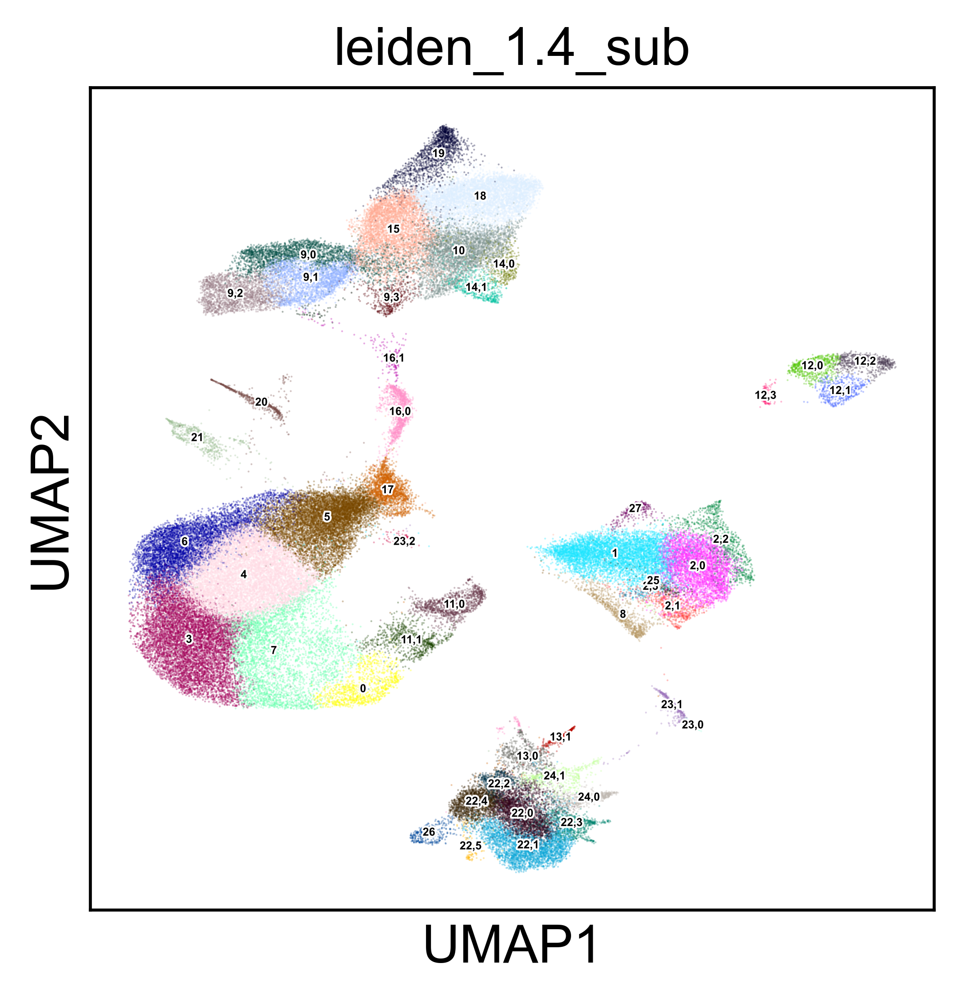

In [30]:
sc.pl.umap(adata, color = ["leiden_1.4_sub"], 
           alpha = 0.33, 
           wspace = 0.5,
           ncols = 3,
           s = 1, 
           legend_loc = "on data", legend_fontsize = 3, legend_fontoutline = True,
           save = "_leiden_1.4_sub_only_v2.png")

In [32]:
# saving clustered UMAP

current_directory = os.getcwd()
fname1 = current_directory+"/backups/bc2_bc3_leiden_1.4_sub_v1_%dx%d_%s.h5ad"%(adata.shape[0],adata.shape[1],now())
print(fname1)
adata.write(fname1)


/Users/denis/microtechnologies/sequencing/240710_BB2_BB3/backups/bc2_bc3_leiden_1.4_sub_v1_95563x2500_240729_18h41.h5ad
